# Optimize parameters for the reference case for LOWESS method

In [1]:
import xarray as xr
import pandas as pd
import numpy as np

import hvplot.xarray
import hvplot.pandas

import matplotlib.pyplot as plt
from cycler import cycler

from sstats import signals as sg
from sstats import sigp as sigp
from sstats import tseries as ts
from sstats import get_cmap_colors

import hvplot.xarray
import hvplot.pandas
import holoviews as hv

import pynsitu as pyn
import lib as lib
from lib import KEYS, raw_dir, images_dir
import os
from glob import glob

import synthetic_traj as st

from synthetic_traj import (
    synthetic_traj,
    random_time_begin,
    noise_irregular_sampling,
    ref_case,
    typical_case,
)

/home1/datahome/mdemol/.miniconda3/envs/mdenv/lib/python3.9/site-packages/pyTMD/tools.py:55: UserWarning: ipyleaflet not available
  warnings.warn("ipyleaflet not available")
/home1/datahome/mdemol/.miniconda3/envs/mdenv/lib/python3.9/site-packages/pyTMD/tools.py:56: UserWarning: Some functions will throw an exception if called
  warnings.warn("Some functions will throw an exception if called")


In [2]:
def ms_diff(DF, true_key, var=["x", "y", "u", "v", "ax", "ay", "X", "U", "Axy"]):
    DF = DF.copy()
    dft = DF[true_key]
    dft_ = (dft.set_index("id")[var]).groupby("id").var()
    dfms = pd.DataFrame(index=DF.keys(), columns=var)
    dfmsr = pd.DataFrame(index=DF.keys(), columns=var)
    for l in DF:
        df = DF[l]
        if np.all(df.index.values == dft.index.values):
            df_ = df.set_index("id")[var] - dft.set_index("id")[var]
            # dfr_ = (df.set_index('id')[var]-dft.set_index('id')[var])/dft.set_index('id')[var]
            dfms.loc[l] = df_.groupby("id").var().mean()
            dfmsr.loc[l] = (df_.groupby("id").var() / dft_).mean()
        else:
            continue
    dfms = pd.concat(
        [dfms, dfmsr.rename(columns={v: "ratio_" + v for v in var})], axis=1
    ).dropna()
    return dfms

___________
# Reference case

In [3]:
N = 50
position_noise = 20
ntype = "white_noise"
offset_type = "svp_scripps_10"
spectral_diff = False
print(ref_case)

dt_rd_begin=10*60

{'T': 5, 'U_low': 0.3, 'U_ni': 0.2, 'U_2': 0, 'U_1': 0, 'tau_eta': 0.1, 'n_layers': 5, 'spectral_diff': False}


In [4]:
ref_case["spectral_diff"] = spectral_diff

___________
# LOWESS

In [4]:
DF = dict()
# TRUE
# t = (50, 1/24/60)
t = (
    50,
    "1min",
)  # use it instead of (50, 1/24/60 because otherwise not regularly sampled

dst = synthetic_traj(t, N, **ref_case)  # u,v, ax, ay computed
dft = st.dataset2dataframe(dst).rename(columns={"draw": "id"})
DF["True_1min"] = dft

# OBSERVED

dso = noise_irregular_sampling(
    dst, t, position_noise, ntype=ntype, offset_type=offset_type, istart=4067
)
dso_ = random_time_begin(dso, dt=dt_rd_begin)#add random begining
dfo = st.dataset2dataframe(dso_).rename(columns={"draw": "id"})
dfo = dfo.groupby("id").apply(pyn.geo.compute_dt, time="index")

DF["Observed"] = dfo

dt_smooth = "30min"
# Interpolated True
dsti = dst.sel(time=pd.date_range(dfo.index.min().ceil(dt_smooth), dfo.index.max(), freq=dt_smooth))
dsti["dt"] = dsti.time.diff("time") / pd.Timedelta("1s")
dfti = st.dataset2dataframe(dsti).rename(columns={"draw": "id"})
dfti = dfti.groupby("id").apply(
    pyn.geo.compute_velocities,
    time="index",
    distance="xy",
    names=("u", "v", "U"),
    fill_startend=True,
    centered=True,
    keep_dt=True,
)
dfti = dfti.groupby("id").apply(
    pyn.geo.compute_accelerations,
    from_=("xy", "x", "y"),
    names=("ax", "ay", "Axy"),
    keep_dt=True,
)

DF["True_" + dt_smooth] = dfti

centred diff
centred diff
14176.644874419177
4067


In [21]:
dfo

,id,x,y,time_days,x_noise,y_noise,X,u,v,U,ax,ay,Axy,au,av,Auv,dt
time,,,,,,,,,,,,,,,,,
2000-01-01 00:10:00,0,-2.480223e+02,-1.766795e+02,0.006944,24.065179,-11.855491,3.045172e+02,-0.640268,-0.285048,0.700854,0.000168,-0.000004,0.000168,0.000158,0.000009,0.000158,600.0
2000-01-01 00:20:00,0,-5.718374e+02,-3.490877e+02,0.013889,-23.136602,-17.093029,6.699704e+02,-0.489404,-0.288496,0.568107,0.000168,-0.000004,0.000168,0.000158,0.000009,0.000158,600.0
2000-01-01 00:30:00,0,-8.353067e+02,-5.228752e+02,0.020833,-14.010976,-22.859133,9.854622e+02,-0.451126,-0.274479,0.528066,-0.000040,0.000051,0.000064,0.000070,0.000025,0.000074,600.0
2000-01-01 00:40:00,0,-1.113188e+03,-6.784628e+02,0.027778,-26.536637,-6.700963,1.303649e+03,-0.405732,-0.258166,0.480903,0.000191,0.000004,0.000191,0.000042,0.000003,0.000043,600.0
2000-01-01 00:50:00,0,-1.322185e+03,-8.326742e+02,0.034722,24.075035,7.770539,1.562536e+03,-0.400236,-0.271077,0.483396,-0.000173,-0.000047,0.000179,-0.000011,-0.000006,0.000012,600.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2000-02-19 23:10:00,29,1.526831e+06,1.281036e+06,49.965278,9.883445,0.253956,1.993054e+06,0.128122,0.717322,0.728675,-0.000108,-0.000012,0.000109,-0.000002,-0.000027,0.000027,600.0
2000-02-19 23:20:00,29,1.526888e+06,1.281464e+06,49.972222,-16.858872,5.834864,1.993373e+06,0.115177,0.700031,0.709443,0.000065,-0.000045,0.000079,0.000025,-0.000018,0.000031,600.0
2000-02-19 23:30:00,29,1.526969e+06,1.281876e+06,49.979167,-20.493090,-0.014720,1.993700e+06,0.158361,0.696056,0.713843,0.000079,0.000032,0.000085,0.000063,-0.000026,0.000069,600.0


In [22]:
dfti

,id,u_low,v_low,u_ni,v_ni,u_2,v_2,u_1,v_1,uo,...,u,v,U,ax,ay,Axy,au,av,Auv,dt
time,,,,,,,,,,,,,,,,,,,,,
2000-01-01 00:30:00,0,-0.458743,-0.302088,0.009047,0.019880,-0.0,0.0,0.0,0.0,-0.449695,...,-0.453994,-0.279391,0.533076,0.000012,-9.883434e-07,0.000012,0.000035,-0.000026,0.000044,1800.0
2000-01-01 01:00:00,0,-0.461820,-0.297142,0.048818,0.018536,-0.0,0.0,0.0,0.0,-0.413002,...,-0.420549,-0.282059,0.506379,0.000012,-9.883434e-07,0.000012,0.000003,0.000009,0.000010,1800.0
2000-01-01 01:30:00,0,-0.464466,-0.292828,0.049557,0.011453,-0.0,0.0,0.0,0.0,-0.414909,...,-0.417110,-0.285884,0.505679,-0.000009,-3.261159e-06,0.000009,-0.000014,0.000014,0.000019,1800.0
2000-01-01 02:00:00,0,-0.466661,-0.289122,0.036147,-0.000768,-0.0,0.0,0.0,0.0,-0.430514,...,-0.428998,-0.294708,0.520474,-0.000005,-6.543616e-06,0.000008,-0.000039,-0.000007,0.000040,1800.0
2000-01-01 02:30:00,0,-0.468400,-0.285943,0.035972,-0.016699,-0.0,0.0,0.0,-0.0,-0.432428,...,-0.434879,-0.307243,0.532464,-0.000002,-7.384047e-06,0.000008,0.000010,0.000007,0.000012,1800.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2000-02-19 21:30:00,29,-0.012192,0.617438,0.144170,0.210599,0.0,0.0,0.0,0.0,0.131978,...,0.120555,0.824336,0.833104,0.000014,-1.636821e-05,0.000021,0.000035,-0.000012,0.000037,1800.0
2000-02-19 22:00:00,29,-0.021501,0.612685,0.155410,0.180293,0.0,0.0,0.0,0.0,0.133909,...,0.137047,0.792021,0.803791,0.000004,-1.953652e-05,0.000020,0.000050,-0.000041,0.000065,1800.0
2000-02-19 22:30:00,29,-0.030083,0.608052,0.175650,0.149984,0.0,0.0,0.0,-0.0,0.145567,...,0.142663,0.752550,0.765953,0.000002,-2.432085e-05,0.000024,0.000010,-0.000019,0.000021,1800.0


In [6]:
param_lowess = dict(degree=2, iteration=3, T_low_pass = 1,nb=4, cutoff_low_pass = 11.5)

___________
# Number of iteration-degree=1


In [31]:
# SMOOTHED
for i in range(2, 5):
    param_lowess['iteration']=i
    dfl = pyn.drifters.smooth_all(
        dfo,
        "lowess",
        dt_smooth,
        parameters=param_lowess,
        spectral_diff=spectral_diff,
        geo=False,
    )
    DF[i] = dfl

Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd wit

In [33]:
dfms = ms_diff(DF, true_key="True_30min").iloc[1:].astype(float)
color = {
    "True_30min": "k",
    "True_1min": "grey",
    1: "teal",
    2: "salmon",
    3: "r",
    4: "darkred",
}
zorder = {"True_30min": 0, "True_1min": 0, 1: 1, 2: 1, 3: 1, 4: 1}

In [34]:
dfms

,x,y,u,v,ax,ay,X,U,Axy,ratio_x,ratio_y,ratio_u,ratio_v,ratio_ax,ratio_ay,ratio_X,ratio_U,ratio_Axy
2,158773.387131,158147.122746,0.000357,0.000356,2.714401e-11,2.733693e-11,158039.447342,0.000317,2.213355e-11,0.000006,0.000006,0.003253,0.003238,0.103878,0.104877,0.000005,0.006197,0.215426
3,158481.811307,159853.433784,0.000355,0.000354,2.729797e-11,2.753500e-11,157345.263596,0.000315,2.234471e-11,0.000006,0.000006,0.003233,0.003215,0.104441,0.105615,0.000005,0.006152,0.217395
4,158576.844456,158139.283209,0.000359,0.000359,2.808847e-11,2.840045e-11,157058.253439,0.000320,2.327046e-11,0.000006,0.000006,0.003274,0.003264,0.107462,0.108929,0.000005,0.006247,0.226451


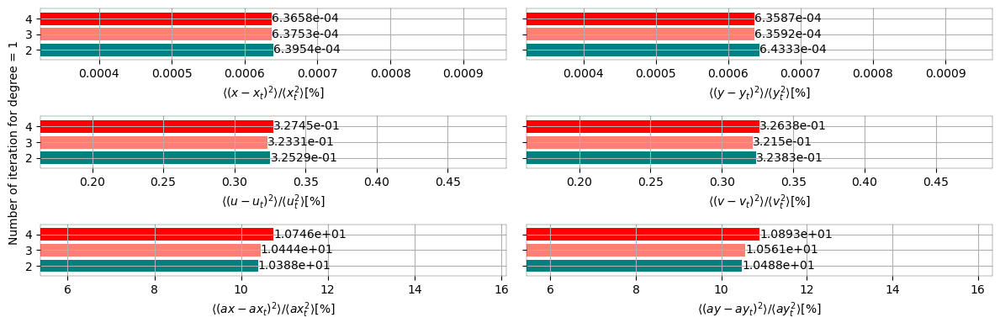

In [36]:
fig, axs = plt.subplots(3, 2, sharey=True, figsize=(12, 4))
i = 0
axs = axs.flatten()
for var in ["x", "y", "u", "v", "ax", "ay"]:
    ax = axs[i]
    (dfms["ratio_" + var] * 100).plot.barh(
        ax=ax, color=["teal", "salmon", "r", "darkred", "teal"], width=0.8
    )
    ax.grid()
    ax.set_xlim(
        0.5 * dfms["ratio_" + var].max() * 100, dfms["ratio_" + var].max() * 1.5 * 100
    )
    i += 1
    ax.set_xlabel(
        rf"$\langle ({var}-{var}_t)^2 \rangle / \langle {var}_t^2 \rangle [\%]$"
    )
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in dfms["ratio_" + var].values * 100
        ],
    )
axs[2].set_ylabel("Number of iteration for degree = 1")
axs[0].set_ylabel("")
axs[4].set_ylabel("")
fig.tight_layout()
fig.savefig(
    os.path.join(images_dir, "LOWESS_opt_norm1.png"), dpi=200, bbox_inches="tight"
)

In [36]:
DF0 = DF.copy()
DF0.pop("True_1min")
DSE = st.spectrum_DF(DF0, nperseg="20D", detrend="linear")
# dse = st.DSE2dse(DSE)
# dsen = sum(st.negpos_spectra(dse))

True_30min
1
2
3
4


In [68]:
def find_fmin_fmax(ds, pourcentage):
    ds = ds.where(ds < pourcentage / 100, drop=True)
    return float(ds.isel(frequency=0).frequency), float(ds.isel(frequency=-1).frequency)


def DSE2dse(DSE):
    ds = xr.concat(
        [d[["x_y", "u_v", "ax_ay"]] for d in DSE.values()], dim=list(DSE.keys())
    )
    return ds.rename({"concat_dim": "Trajectory"})


DF_diff = st.build_DF_diff(DF0, true_key="True_30min")
DSE_d = st.spectrum_DF(DF_diff)
dse_d = DSE2dse(DSE_d)

DSE_dn = DSE_d.copy()
for l in DSE_d:
    DSE_dn[l] = DSE_d[l] / DSE["True_30min"]

Fu = {l: find_fmin_fmax(DSE_dn[l].u_v.mean("id"), 10) for l in DSE_dn}
Fa = {l: find_fmin_fmax(DSE_dn[l].ax_ay.mean("id"), 10) for l in DSE_dn}

dsen, dsep = st.negpos_spectra(dse_d.mean("id"))
# dsen_ = (dsen.cumulative_integrate('frequency'))/(dse_d.mean('id').integrate('frequency'))
# dsep_ = (dsep.cumulative_integrate('frequency'))/(dse_d.mean('id').integrate('frequency'))
dsen_ = (dsen.cumulative_integrate("frequency")) / (dsen.integrate("frequency"))
dsep_ = (dsep.cumulative_integrate("frequency")) / (dsep.integrate("frequency"))
dsen_["frequency"] = -dsen_["frequency"]
dsen_ = dsen_.sortby("frequency")
dse_ = xr.combine_by_coords([dsen_, dsep_])

Observed has not the same time index
1
2
3
4


___________
# Number of points


In [ ]:
# SMOOTHED
for i in range(2, 7, 2):
    param_lowess['nb']=i
    dfl = pyn.drifters.smooth_all(
        dfo,
        "lowess",
        dt_smooth,
        parameters=param_lowess,
        spectral_diff=spectral_diff,
        geo=False,
    )
    DF[i] = dfl

Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad
Divided into 1 segments
LOW-PASS : 11.5cpd with 1pad


In [9]:
dfms = ms_diff(DF, true_key="True_30min").iloc[1:].astype(float)
color = {
    "True_30min": "k",
    "True_1min": "grey",
    2: "teal",
    4: "salmon",
    6: "r",
    8: "darkred",
    10:'blue'
}
zorder = {"True_30min": 0, "True_1min": 0, 2: 1, 4: 1, 6: 1, 8: 1, 10:1}

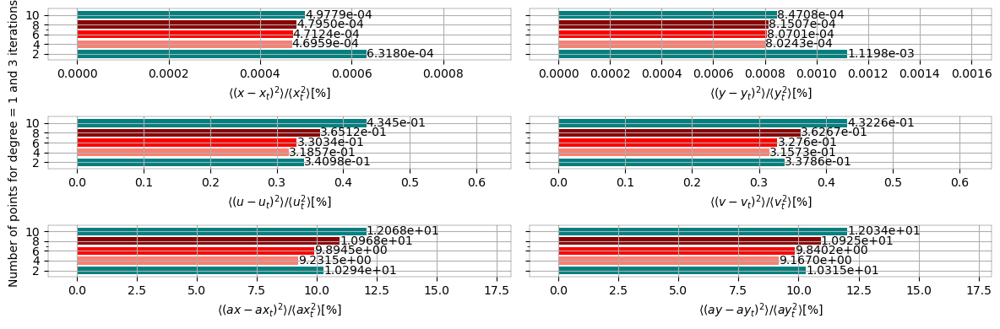

In [10]:
fig, axs = plt.subplots(3, 2, sharey=True, figsize=(12, 4))
i = 0
axs = axs.flatten()
for var in ["x", "y", "u", "v", "ax", "ay"]:
    ax = axs[i]
    (dfms["ratio_" + var] * 100).plot.barh(
        ax=ax, color=["teal", "salmon", "r", "darkred", "teal"], width=0.8
    )
    ax.grid()
    ax.set_xlim(
        -0.1 * dfms["ratio_" + var].max() * 100, dfms["ratio_" + var].max() * 1.5 * 100
    )
    i += 1
    ax.set_xlabel(
        rf"$\langle ({var}-{var}_t)^2 \rangle / \langle {var}_t^2 \rangle [\%]$"
    )
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in dfms["ratio_" + var].values * 100
        ],
    )
axs[2].set_ylabel("Number of points for degree = 1 and 3 iterations")
axs[0].set_ylabel("")
axs[4].set_ylabel("")
fig.tight_layout()
fig.savefig(
    os.path.join(images_dir, "LOWESS_opt_norm1.png"), dpi=200, bbox_inches="tight"
)

___________
# Degree

In [72]:
DF2 = dict()
DF2["True_30min"] = DF["True_30min"]
# SMOOTHED
dt_smooth = "30min"
dfl2 = pyn.drifters.smooth_all(
    dfo,
    "lowess",
    dt_smooth,
    parameters=dict(degree=2, iteration=3),
    spectral_diff=spectral_diff,
    geo=False,
)
dfl3 = pyn.drifters.smooth_all(
    dfo,
    "lowess",
    dt_smooth,
    parameters=dict(degree=3, iteration=3),
    spectral_diff=spectral_diff,
    geo=False,
)

DF2[1] = dfl2
DF2[2] = dfl3

## Hvplot

In [5]:
d = 0
st.hvplot_DF(DF, d, ["x", "y", "u", "v", "ax", "ay"])

6


:Layout
   .Overlay.I   :Overlay
      .Curve.True_1min.I            :Curve   [time]   (x)
      .Curve.True_1min.II           :Curve   [time]   (x)
      .Curve.Observed               :Curve   [time]   (x)
      .Curve.LOWESS_degree_equals_1 :Curve   [time]   (x)
      .Curve.LOWESS_degree_equals_2 :Curve   [time]   (x)
      .Curve.True_30min             :Curve   [time]   (x)
   .Overlay.II  :Overlay
      .Curve.True_1min.I            :Curve   [time]   (y)
      .Curve.True_1min.II           :Curve   [time]   (y)
      .Curve.Observed               :Curve   [time]   (y)
      .Curve.LOWESS_degree_equals_1 :Curve   [time]   (y)
      .Curve.LOWESS_degree_equals_2 :Curve   [time]   (y)
      .Curve.True_30min             :Curve   [time]   (y)
   .Overlay.III :Overlay
      .Curve.True_1min.I            :Curve   [time]   (u)
      .Curve.True_1min.II           :Curve   [time]   (u)
      .Curve.Observed               :Curve   [time]   (u)
      .Curve.LOWESS_degree_equals_1 :Curve   [time]   (u)
      .Curve.LOWESS_degree_equals_2 :Curve   [time]   (u)
      .Curve.True_30min             :Curve   [time]   (u)
   .Overlay.IV  :Overlay
      .Curve.True_1min.I            :Curve   [time]   (v)
      .Curve.True_1min.II           :Curve   [time]   (v)
      .Curve.Observed               :Curve   [time]   (v)
      .Curve.LOWESS_degree_equals_1 :Curve   [time]   (v)
      .Curve.LOWESS_degree_equals_2 :Curve   [time]   (v)
      .Curve.True_30min             :Curve   [time]   (v)
   .Overlay.V   :Overlay
      .Curve.True_1min.I            :Curve   [time]   (ax)
      .Curve.True_1min.II           :Curve   [time]   (ax)
      .Curve.Observed               :Curve   [time]   (ax)
      .Curve.LOWESS_degree_equals_1 :Curve   [time]   (ax)
      .Curve.LOWESS_degree_equals_2 :Curve   [time]   (ax)
      .Curve.True_30min             :Curve   [time]   (ax)
   .Overlay.VI  :Overlay
      .Curve.True_1min.I            :Curve   [time]   (ay)
      .Curve.True_1min.II           :Curve   [time]   (ay)
      .Curve.Observed               :Curve   [time]   (ay)
      .Curve.LOWESS_degree_equals_1 :Curve   [time]   (ay)
      .Curve.LOWESS_degree_equals_2 :Curve   [time]   (ay)
      .Curve.True_30min             :Curve   [time]   (ay)


## Mean square values of the differences $\langle (x-x_t)^2 \rangle $ and mean square values of the  relative difference $ \frac{\langle(x-x_t)^2\rangle}{\langle x_t^2 \rangle} $

In [78]:
dfms = st.ms_diff(DF2, true_key="True_" + dt_smooth).iloc[1:, :].astype(float)
color = {"True_30min": "k", "True_1min": "grey", 1: "teal", 2: "salmon"}
zorder = {"True_30min": 0, "True_1min": 0, 1: 2, 2: 3}

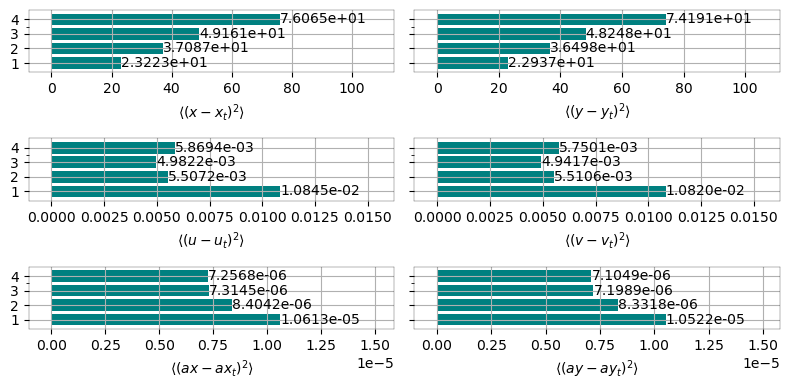

In [77]:
fig, axs = plt.subplots(3, 2, sharey=True, figsize=(8, 4))
i = 0
axs = axs.flatten()
for var in ["x", "y", "u", "v", "ax", "ay"]:
    ax = axs[i]
    np.sqrt(dfms[var]).plot.barh(ax=ax, color="teal", width=0.8)
    ax.grid()
    ax.set_xlim(-0.1 * np.sqrt(dfms[var]).max(), np.sqrt(dfms[var]).max() * 1.5)
    i += 1
    ax.set_xlabel(rf"$\langle ({var}-{var}_t)^2 \rangle$")
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in np.sqrt(dfms[var]).values
        ],
    )
fig.tight_layout()

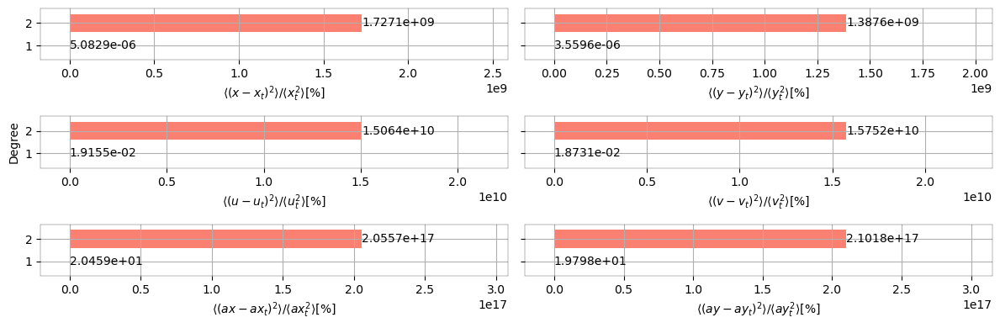

In [79]:
fig, axs = plt.subplots(3, 2, sharey=True, figsize=(12, 4))
i = 0
axs = axs.flatten()
for var in ["x", "y", "u", "v", "ax", "ay"]:
    ax = axs[i]
    (dfms["ratio_" + var] * 100).plot.barh(
        ax=ax, color=["teal", "salmon", "red"], width=0.8
    )
    ax.grid()
    ax.set_xlim(
        -0.1 * dfms["ratio_" + var].max() * 100, dfms["ratio_" + var].max() * 1.5 * 100
    )
    i += 1
    ax.set_xlabel(
        rf"$\langle ({var}-{var}_t)^2 \rangle / \langle {var}_t^2 \rangle [\%]$"
    )
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in dfms["ratio_" + var].values * 100
        ],
    )
axs[2].set_ylabel("Degree")
axs[0].set_ylabel("")
axs[4].set_ylabel("")
fig.tight_layout()
fig.savefig(
    os.path.join(images_dir, "LOWESS_opt_norm.png"), dpi=200, bbox_inches="tight"
)

## Spectra

In [10]:
DF0 = DF.copy()
# DF0.pop('True_1min')
DSE = st.spectrum_DF(DF0, nperseg="20D", detrend="linear")
# dse = st.DSE2dse(DSE)
# dsen = sum(st.negpos_spectra(dse))

True_1min
LOWESS degree =1
LOWESS degree =2
True_30min


In [124]:
(DF["True_30min"].set_index("id").ax ** 2).groupby("id").mean().mean() + (
    DF["True_30min"].set_index("id").ay ** 2
).groupby("id").mean().mean()

5.115554461514916e-10

In [125]:
DSE["True_30min"].ax_ay.integrate("frequency").mean()

<xarray.DataArray 'ax_ay' ()>
array(5.17004938e-10)

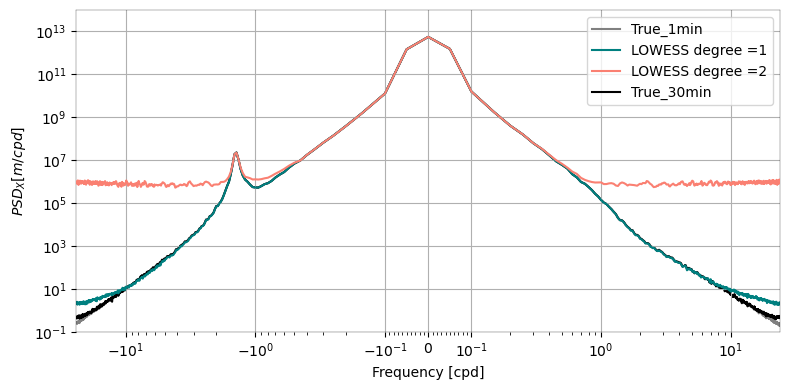

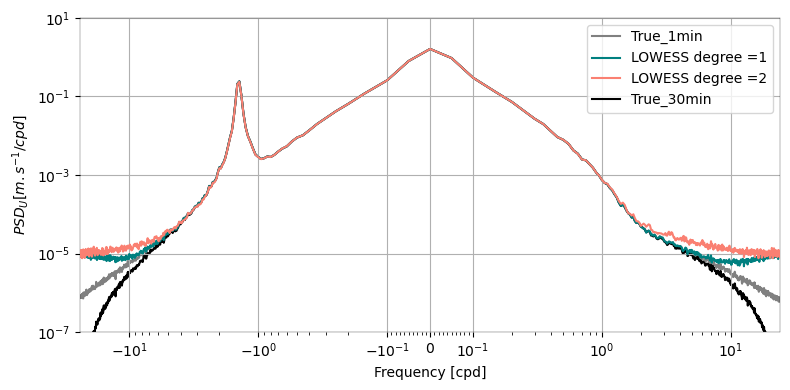

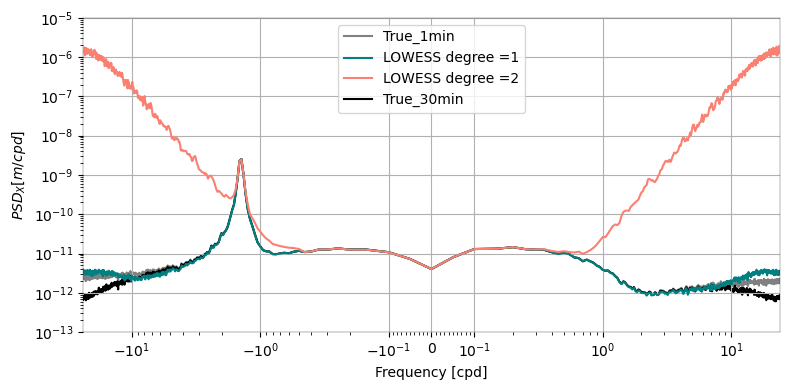

In [9]:
linthresh = 1e-1
linscale = 0.3

fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for l in DSE.keys():
    DSE[l].x_y.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
ax.set_ylim(1e-1, 1e14)
ax.legend()
ax.set_ylabel(r"$PSD_{X} [m/cpd]$")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
fig.tight_layout()

fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for l in DSE.keys():
    DSE[l].u_v.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
ax.set_ylim(1e-7, 1e1)
ax.legend()
ax.set_ylabel(r"$PSD_{U} [m.s^{-1}/cpd]$")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
fig.tight_layout()

fig, ax = plt.subplots(1, 1, figsize=(8, 4))
for l in DSE.keys():
    DSE[l].ax_ay.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
ax.set_ylim(1e-13, 1e-5)
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()
ax.set_ylabel(r"$PSD_{X} [m/cpd]$")
ax.set_xlabel("Frequency [cpd]")
fig.tight_layout()

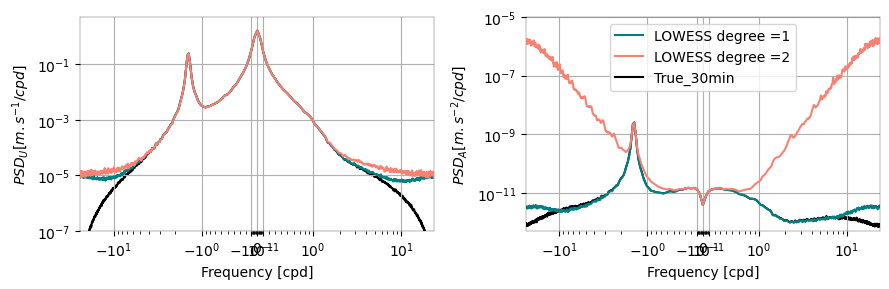

In [11]:
linthresh = 5e-1
linscale = 0.3
color = {
    "True_30min": "k",
    "True_1min": "grey",
    "LOWESS degree =1": "teal",
    "LOWESS degree =2": "salmon",
}
zorder = {"True_30min": 0, "True_1min": 0, "LOWESS degree =1": 2, "LOWESS degree =2": 3}

fig, axs = plt.subplots(1, 2, figsize=(9, 3))
ax = axs[0]
for l in DSE.keys():
    if l != "True_1min":
        DSE[l].u_v.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
ax.set_ylim(1e-7, 5e0)
ax.set_ylabel(r"$PSD_{U} [m.s^{-1}/cpd]$")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))

ax = axs[1]
for l in DSE.keys():
    if l != "True_1min":
        DSE[l].ax_ay.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
ax.set_ylim(5e-13, 1e-5)
ax.set_ylabel(r"$PSD_{A} [m.s^{-2}/cpd]$")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()
fig.tight_layout()
fig.savefig(
    os.path.join(images_dir, "LOWESS_opt_spectra.png"), dpi=200, bbox_inches="tight"
)

## Spectra of the diff

In [13]:
DF_diff = st.build_DF_diff(DF, true_key="True_30min")
DSE_d = st.spectrum_DF(DF_diff)

True_1min has not the same time index
Observed has not the same time index
LOWESS degree =1
LOWESS degree =2


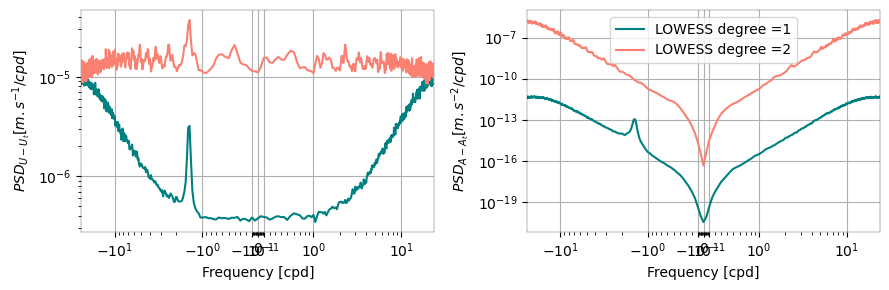

In [14]:
linthresh = 5e-1
linscale = 0.3
color = {
    "True_30min": "k",
    "True_1min": "grey",
    "LOWESS degree =1": "teal",
    "LOWESS degree =2": "salmon",
}
zorder = {"True_30min": 0, "True_1min": 0, "LOWESS degree =1": 2, "LOWESS degree =2": 3}

fig, axs = plt.subplots(1, 2, figsize=(9, 3))
ax = axs[0]
for l in DSE_d.keys():
    DSE_d[l].u_v.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
# ax.set_ylim(1e-7, 5e0)
ax.set_ylabel(r"$PSD_{U-U_t} [m.s^{-1}/cpd]$")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))

ax = axs[1]
for l in DSE_d.keys():
    DSE_d[l].ax_ay.mean("id").plot(ax=ax, color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
# ax.set_ylim(5e-13, 1e-5)
ax.set_ylabel(r"$PSD_{A-A_t} [m.s^{-2}/cpd]$")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()
fig.tight_layout()
fig.savefig(
    os.path.join(images_dir, "LOWESS_opt_diffspectra.png"), dpi=200, bbox_inches="tight"
)

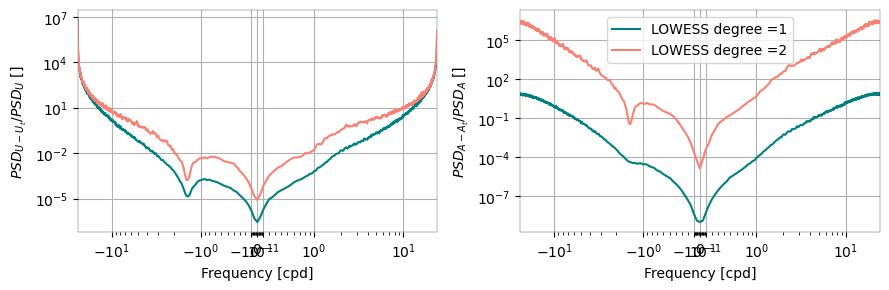

In [15]:
linthresh = 5e-1
linscale = 0.3
color = {
    "True_30min": "k",
    "True_1min": "grey",
    "LOWESS degree =1": "teal",
    "LOWESS degree =2": "salmon",
}
zorder = {"True_30min": 0, "True_1min": 0, "LOWESS degree =1": 2, "LOWESS degree =2": 3}

fig, axs = plt.subplots(1, 2, figsize=(9, 3))
ax = axs[0]
for l in DSE_d.keys():
    (DSE_d[l].u_v / DSE["True_30min"].u_v).mean("id").plot(
        ax=ax, color=color[l], zorder=zorder[l], label=l
    )
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
# ax.set_ylim(1e-7, 5e0)
ax.set_ylabel(r"$PSD_{U-U_t}/PSD_{U}$ []")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))

ax = axs[1]
for l in DSE_d.keys():
    (DSE_d[l].ax_ay / DSE["True_30min"].ax_ay).mean("id").plot(
        ax=ax, color=color[l], zorder=zorder[l], label=l
    )
ax.grid()
ax.set_xscale("symlog", linthresh=linthresh, linscale=linscale)
ax.set_yscale("log")
ax.set_xlim(-24 * 60 / 30 / 2, 24 * 60 / 30 / 2)
# ax.set_ylim(5e-13, 1e-5)
ax.set_ylabel(r"$PSD_{A-A_t}/PSD_{A}$ []")
ax.set_xlabel("Frequency [cpd]")
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()
fig.tight_layout()
fig.savefig(
    os.path.join(images_dir, "LOWESS_opt_diffspectra_normed.png"),
    dpi=200,
    bbox_inches="tight",
)

## Integration per band

In [32]:
dsib = st.ds_int_band(dsen).mean("id")
dsib

<xarray.Dataset>
Dimensions:     (Trajectory: 4)
Coordinates:
  * Trajectory  (Trajectory) object 'True_1min' 'LOWESS degree =2' ... 'True_2h'
Data variables:
    bf_x_y      (Trajectory) float64 nan 4.885e+11 4.885e+11 4.885e+11
    bf_u_v      (Trajectory) float64 nan 0.2421 0.2438 0.2422
    bf_ax_ay    (Trajectory) float64 nan 1.006e-11 7.552e-11 1.132e-11
    ni_x_y      (Trajectory) float64 nan 5.48e+06 1.24e+09 5.558e+06
    ni_u_v      (Trajectory) float64 nan 0.04332 0.04387 0.04392
    ni_ax_ay    (Trajectory) float64 nan 4.391e-10 3.164e-07 4.499e-10
    hf_x_y      (Trajectory) float64 nan 6.089e+03 2.205e+09 6.306e+03
    hf_u_v      (Trajectory) float64 nan 0.0003396 0.003804 0.0003636
    hf_ax_ay    (Trajectory) float64 nan 2.593e-11 2.626e-05 3.36e-11

In [45]:
dfib = dsib.to_dataframe().dropna()
dfib

,bf_x_y,bf_u_v,bf_ax_ay,ni_x_y,ni_u_v,ni_ax_ay,hf_x_y,hf_u_v,hf_ax_ay
Trajectory,,,,,,,,,
LOWESS degree =2,4.884707e+11,0.242117,1.006155e-11,5.480338e+06,0.043318,4.391178e-10,6.089047e+03,0.000340,2.592858e-11
LOWESS degree =3,4.885102e+11,0.243811,7.551980e-11,1.240273e+09,0.043872,3.163533e-07,2.204985e+09,0.003804,2.625624e-05
True_2h,4.884693e+11,0.242241,1.131873e-11,5.558256e+06,0.043921,4.499343e-10,6.306357e+03,0.000364,3.359586e-11


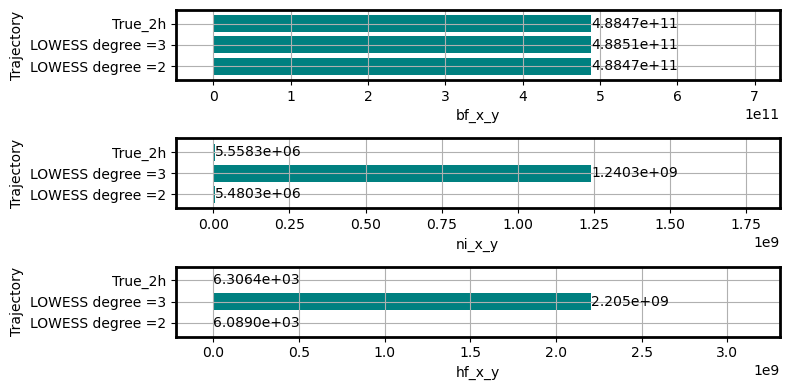

In [71]:
fig, axs = plt.subplots(3, 1, sharey=True, figsize=(8, 4))
i = 0
axs = axs.flatten()
for var in ["bf_x_y", "ni_x_y", "hf_x_y"]:
    ax = axs[i]
    dfib[var].plot.barh(ax=ax, color="teal", width=0.8)
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in dfib[var].values
        ],
    )
    ax.grid()
    ax.set_xlim(-0.1 * dfib[var].max(), dfib[var].max() * 1.5)
    ax.set_xlabel(var)
    i += 1
fig.tight_layout()

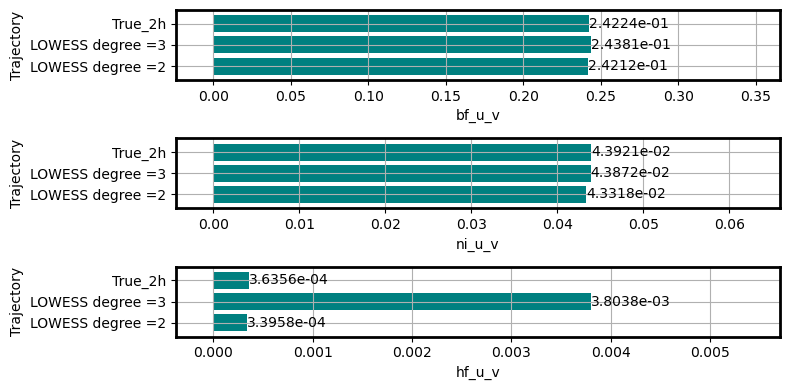

In [72]:
fig, axs = plt.subplots(3, 1, sharey=True, figsize=(8, 4))
i = 0
axs = axs.flatten()
for var in ["bf_u_v", "ni_u_v", "hf_u_v"]:
    ax = axs[i]
    dfib[var].plot.barh(ax=ax, color="teal", width=0.8)
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in dfib[var].values
        ],
    )
    ax.grid()
    ax.set_xlim(-0.1 * dfib[var].max(), dfib[var].max() * 1.5)
    ax.set_xlabel(var)
    i += 1
fig.tight_layout()

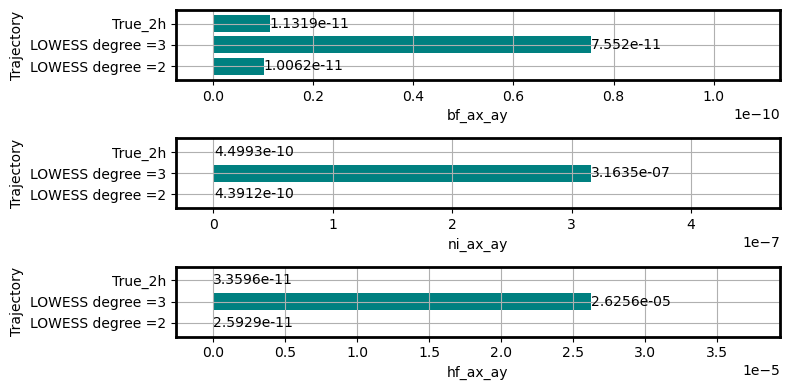

In [73]:
fig, axs = plt.subplots(3, 1, sharey=True, figsize=(8, 4))
i = 0
axs = axs.flatten()
for var in ["bf_ax_ay", "ni_ax_ay", "hf_ax_ay"]:
    ax = axs[i]
    dfib[var].plot.barh(ax=ax, color="teal", width=0.8)
    ax.bar_label(
        ax.containers[0],
        labels=[
            np.format_float_scientific(l, precision=4, exp_digits=2)
            for l in dfib[var].values
        ],
    )
    ax.grid()
    ax.set_xlim(-0.1 * dfib[var].max(), dfib[var].max() * 1.5)
    ax.set_xlabel(var)
    i += 1
fig.tight_layout()